# Training Custom ResNet
___

## Table of contents
1. [Imports](#Imports)
2. [LoadData](#LoadData)
3. [Config](#Configs)
4. [Analysis](#Analysis)
5. [Process](#Process)

## Imports

In [1]:
import os
import numpy as np
import pandas as pd

import optuna
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from torch.utils.data import Dataset,DataLoader,random_split
from torch.utils.tensorboard import SummaryWriter
import torchvision
from torchvision import models, transforms
from torch_lr_finder import LRFinder

from tqdm.notebook import tqdm

import math
import pretrainedmodels as ptm
import h5py
import copy
from datetime import datetime
import matplotlib.pyplot as plt

In [2]:
from Library.datasets import DatasetH5TwoRandom, DatasetH5ForTest, compute_std_mean
from Library.transforms import RandomFlip,RandomOffset,RandomRotateGrayscale
from Library.scheduler import OneCycleLR,LogLR
from Library.cresnet import initialize_cresnet
from Library.dml import RefBasedDeepMetric
from Library.models.FeatureExtractor import FeatureExtractor, Block, CustomNet
from Library.trainers import RefBasedDeepMetricTrainer

In [3]:
from Library.util import (
    jupyter_wide_screen,
    strings_contain_words, 
    strings_contain_patterns, 
    add_unique_entry
)

jupyter_wide_screen()

## LoadData

#### To initialize dataset: obtain References and Dataset object

In [4]:
def init_dataset(data_path, fnames):

    mean_val = 47.8577 # 3 Seq mean_val
    std_val = 51.4139   # 3 Seq std_val
    ds_h5 = []
    refs_list = []
    
    ### 可能还需要用 transforms.RandomHorizontalFlip()
    #img_transforms = [transforms.ToTensor(),transforms.Normalize((mean_val,),(std_val,))] # 先标准化处理
    img_transforms = [RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    comb = os.path.join(data_path, fnames)
    
    # to obtain the 2,3,4 Seq data
    for i in range(2,5):
        h5_fpath = comb.format(i)
        h5_f = DatasetH5TwoRandom(h5_fpath,transform = composed_img_transforms)
        
        # obtain the references, the first 10 images in every Seq.
        refs = h5_f.getRef()
        refs_list.append(refs)
        
        ds_h5.append(h5_f)

    return refs_list, ds_h5

In [5]:
# 1 stripe
data_path_type2 = "../MA/NewData/21503_1000200411_653340003"
fnames_type2 = "trueroi_filtered_phase2_1_{}.h5" # 2,3,4
refs_list, ds_h5 = init_dataset(data_path_type2,fnames_type2)

#### Dataloader for training set ,validation set, test set (60%,20%,20%)

In [6]:
batch_sizes = [32, 32, 32]
shuffle_flags = [True, False, False]
ds_ratio = [0.6, 0.2, 0.2]

def init_dataloaders(datasets,ds_ratio):
    dataloaders = []
    
    for ds in datasets:
        splitted_ds_num_data = [round(len(ds) * ds_ratio[i]) for i in range(len(ds_ratio))]
        splitted_ds_num_data[0] += len(ds) - int(np.sum(splitted_ds_num_data))

        splitted_ds = []

        for tmp_ds, batch_size, shuffle in zip(random_split(ds, splitted_ds_num_data), batch_sizes, shuffle_flags):

            splitted_ds.append(
                DataLoader(
                    tmp_ds,
                    batch_size=batch_size,
                    shuffle=shuffle,
                    drop_last=True,
                )
            )

        dataloaders.append(splitted_ds)
    return dataloaders

In [7]:
dataloaders = init_dataloaders(ds_h5, ds_ratio)

train_dls = [dls[0] for dls in dataloaders]
valid_dls = [dls[1] for dls in dataloaders]
test_dls = [dls[2] for dls in dataloaders]

## FeatureExtractor

In [8]:
class FeatureExtractor(nn.Module):
    # Custom feature extraction model from pretrained ResNet50

    def __init__(self, model,zero_init_residual=False):
        super(FeatureExtractor, self).__init__()
        
        self.conv1= nn.Conv2d(1, 64, 3, 2, 1)
        self.bn1 = model.bn1
        self.relu = nn.LeakyReLU(0.1)
        #self.relu = model.relu
        self.maxpool = model.maxpool

        self.layer1 = model.layer1
        self.layer2 = model.layer2

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Sequential(nn.Linear(512, 64))
                
        # weights initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode = 'fan_in', nonlinearity = 'leaky_relu')

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        if zero_init_residual:
            for m in self.modules():
                if isinstance(m, Bottleneck):
                    nn.init.constant_(m.bn3.weight, 0)
                elif isinstance(m, BasicBlock):
                    nn.init.constant_(m.bn2.weight, 0)

    def forward(self, x):

        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        
        self.featuremap0 = x.detach() # 核心代码

        x = self.layer1(x)
        self.featuremap1 = x.detach() # 核心代码
        
        x = self.layer2(x)
        self.featuremap2 = x.detach() # 核心代码
        
        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)

        x = self.fc(x)
        self.featuremapfc = x.detach() # 核心代码
        
        # 使用的时候 : feature_output1 = model.featuremap1.transpose(1,0).cpu()
        
        return x
    
    def show_intermediate_shape(self, x):
        x = self.conv1(x)
        print("After conv1: ", x.shape)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        print("After maxpool: ", x.shape)
        x = self.layer1(x)
        print("After layer1: ", x.shape)
        x = self.layer2(x)
        print("After layer2,before avgpool: ", x.shape)
        
        x = self.avgpool(x)
        print("After avgpool,before reshape: ", x.shape)
        x = x.reshape(x.shape[0], -1)
        print("After reshape: ", x.shape)
        x = self.fc(x)
        print("In FC: ", x.shape)

## SiameseNet structure

In [ ]:
class SiameseNet(nn.Module):
    def __init__(self, model):
        super(SiameseNet, self).__init__()
        self.model = model
        
    def _calculate_loss(self, v1, v2, refs_vectors):
        r"""Calculate distance between vector of img1&img2 and each reference images

        Args:
            v1 (Tensor, torch.Size[batchsize,128]): batch of img1s from feature extractor
            v2 (Tensor, torch.Size[batchsize,128]): batch of img2s from feature extractor
            refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
        """
        v_dim = v1.size(1)
        num_ref = len(refs_vectors)

        # concatenate the refs tensor
        for i,vec in enumerate(refs_vectors):
            if i == 0:
                refs_tensor = vec
            else:
                refs_tensor = torch.cat((refs_tensor,vec),dim = 0)


        v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
        v22 = v2.unsqueeze(1).repeat(1, num_ref, 1)
        refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size

        kernel_matrix1 = (v11-refs).pow(2).sum(2) #torch.Size([batchsize, 10])
        kernel_matrix2 = (v22-refs).pow(2).sum(2) #torch.Size([batchsize, 10])

        v1_distance_mean = torch.mean(kernel_matrix1,dim = 1) #torch.Size([batchsize])
        v2_distance_mean = torch.mean(kernel_matrix2,dim = 1) #torch.Size([batchsize])
        
        diff = v1_distance_mean - v2_distance_mean
        
        #print("Before Sigmoid outputs",outputs)
        sigmoid = nn.Sigmoid()
        outputs = sigmoid(diff)
        #print("After Sigmoid outputs",outputs)

        return outputs

    def forward(self, x1, x2, refs):
        v1 = self.model(x1)
        v2 = self.model(x2)
        feature_refs = [self.model(ref) for ref in refs]
        
        outputs = self._calculate_loss(v1, v2, feature_refs)
        return outputs
    
    # This function used to plot the degradation metric , x1 is the sequential image
    def forward_test(self, x1, refs):
        v1 = self.model(x1)
        feature_refs = [self.model(ref) for ref in refs]
        
        return v1, feature_refs
    
    def get_model(self, x):
        return self.model(x)


#### Load pretrained ResNet

In [9]:
res_model = models.resnet50(pretrained=True)
feature_extractor = FeatureExtractor(res_model)
model = RefBasedDeepMetric(feature_extractor,loss_non_linearity_name='sigmoid',criterion_name='bce',)
#model = SiameseNet(feature_extractor)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

RefBasedDeepMetric(
  (feature_extractor): FeatureExtractor(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): LeakyReLU(negative_slope=0.1)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downs

In [10]:
x = torch.randn(32,1,720,24)
model.feature_extractor.show_intermediate_shape(x.to(device))

After conv1:  torch.Size([32, 64, 360, 12])
After maxpool:  torch.Size([32, 64, 180, 6])
After layer1:  torch.Size([32, 256, 180, 6])
After layer2,before avgpool:  torch.Size([32, 512, 90, 3])
After avgpool,before reshape:  torch.Size([32, 512, 1, 1])
After reshape:  torch.Size([32, 512])
In FC:  torch.Size([32, 64])


# Define the degradation metrics function

In [ ]:
def degradation_metrics(v1, refs_vectors):
    r"""Calculate distance between vector of img1&img2 and each reference images
    Args:
        v1 (Tensor, torch.Size[batchsize,128]): batch of imgs from feature extractor
        
        refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
    """
    v_dim = v1.size(1) # 128
    num_ref = len(refs_vectors)
    
    # concatenate the refs tensor
    for i,vec in enumerate(refs_vectors):
        if i == 0:
            refs_tensor = vec
        else:
            refs_tensor = torch.cat((refs_tensor,vec),dim = 0)

    v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
    refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size
    
    kernel_matrix1 = (v11-refs).pow(2).sum(2) 
    
    metric = torch.mean(kernel_matrix1,dim = 1) 

    return metric

## Learning Rate Test

In [11]:
from torch.optim.lr_scheduler import _LRScheduler
from torch_lr_finder import LRFinder ,TrainDataLoaderIter, ValDataLoaderIter

In [12]:
class CustomTrainIter(TrainDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels
    
    def __next__(self):
        try:
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)
        except StopIteration:
            if not self.auto_reset:
                raise
            self._iterator = iter(self.data_loader)
            batch = next(self._iterator)
            img1, img2, labels = self.inputs_labels_from_batch(batch)

        return img1, img2, labels

In [13]:
class CustomValIter(ValDataLoaderIter):
    def inputs_labels_from_batch(self, batch_data):
        img1, img2, labels = batch_data
        return img1, img2, labels

In [14]:
class LinearLR(_LRScheduler):
    """Linearly increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(LinearLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr + r * (self.end_lr - base_lr) for base_lr in self.base_lrs]

In [15]:
class ExponentialLR(_LRScheduler):
    """Exponentially increases the learning rate between two boundaries over a number of
    iterations.

    Arguments:
        optimizer (torch.optim.Optimizer): wrapped optimizer.
        end_lr (float): the final learning rate.
        num_iter (int): the number of iterations over which the test occurs.
        last_epoch (int, optional): the index of last epoch. Default: -1.
    """

    def __init__(self, optimizer, end_lr, num_iter, last_epoch=-1):
        self.end_lr = end_lr

        if num_iter <= 1:
            raise ValueError("`num_iter` must be larger than 1")
        self.num_iter = num_iter

        super(ExponentialLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        # In earlier Pytorch versions last_epoch starts at -1, while in recent versions
        # it starts at 0. We need to adjust the math a bit to handle this. See
        # discussion at: https://github.com/davidtvs/pytorch-lr-finder/pull/42
        
        r = self.last_epoch / (self.num_iter - 1)

        return [base_lr * (self.end_lr / base_lr) ** r for base_lr in self.base_lrs]

In [16]:
try:
    from apex import amp

    IS_AMP_AVAILABLE = True
except ImportError:
    IS_AMP_AVAILABLE = False
    
class CustomLRFinder(LRFinder):
    
    def custom_range_test(
        self,
        train_loader,
        curr_refs,
        val_loader=None,
        start_lr=None,
        end_lr=10,
        num_iter=100,
        step_mode="exp",
        smooth_f=0.05,
        diverge_th=5,
        accumulation_steps=1,
        non_blocking_transfer=True,
    ):
       
        # Reset test results
        self.history = {"lr": [], "loss": []}
        self.best_loss = None

        # Move the model to the proper device
        self.model.to(self.device)

        # Check if the optimizer is already attached to a scheduler
        self._check_for_scheduler()

        # Set the starting learning rate
        if start_lr:
            self._set_learning_rate(start_lr)

        # Initialize the proper learning rate policy
        if step_mode.lower() == "exp":
            lr_schedule = ExponentialLR(self.optimizer, end_lr, num_iter)
        elif step_mode.lower() == "linear":
            lr_schedule = LinearLR(self.optimizer, end_lr, num_iter)
        else:
            raise ValueError("expected one of (exp, linear), got {}".format(step_mode))

        if smooth_f < 0 or smooth_f >= 1:
            raise ValueError("smooth_f is outside the range [0, 1[")

        # Create an iterator to get data batch by batch
        if isinstance(train_loader, DataLoader):
            train_iter = TrainDataLoaderIter(train_loader)
        elif isinstance(train_loader, TrainDataLoaderIter):
            train_iter = train_loader
        else:
            raise ValueError(
                "`train_loader` has unsupported type: {}."
                "Expected types are `torch.utils.data.DataLoader`"
                "or child of `TrainDataLoaderIter`.".format(type(train_loader))
            )

        if val_loader:
            if isinstance(val_loader, DataLoader):
                val_iter = CustomValIter(val_loader)
            elif isinstance(val_loader, ValDataLoaderIter):
                val_iter = val_loader
            else:
                raise ValueError(
                    "`val_loader` has unsupported type: {}."
                    "Expected types are `torch.utils.data.DataLoader`"
                    "or child of `ValDataLoaderIter`.".format(type(val_loader))
                )

        for iteration in tqdm(range(num_iter)):
            # Train on batch and retrieve loss
            loss = self._train_batch(
                train_iter,
                curr_refs,
                accumulation_steps,
                non_blocking_transfer= non_blocking_transfer,
            )
            if val_loader:
                loss = self._validate(
                    val_iter, curr_refs, non_blocking_transfer=non_blocking_transfer
                )

            # Update the learning rate
            self.history["lr"].append(lr_schedule.get_lr()[0])
            lr_schedule.step()

            # Track the best loss and smooth it if smooth_f is specified
            if iteration == 0:
                self.best_loss = loss
            else:
                if smooth_f > 0:
                    loss = smooth_f * loss + (1 - smooth_f) * self.history["loss"][-1]
                if loss < self.best_loss:
                    self.best_loss = loss

            # Check if the loss has diverged; if it has, stop the test
            self.history["loss"].append(loss)
            if loss > diverge_th * self.best_loss:
                print("Stopping early, the loss has diverged")
                break

        print("Learning rate search finished. See the graph with {finder_name}.plot()")

    def _train_batch(self, train_iter, curr_refs, accumulation_steps, non_blocking_transfer=True):
        self.model.train()
        total_loss = None  # for late initialization
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.optimizer.zero_grad()
        curr_refs = curr_refs.float().to(device)

        for i in range(accumulation_steps):
            img1, img2, labels = next(train_iter)
            labels = labels.view(-1)
            labels = labels.to(device)
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)

            # Forward pass
            loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)

            # Loss should be averaged in each step
            loss /= accumulation_steps

            # Backward pass
            if IS_AMP_AVAILABLE and hasattr(self.optimizer, "_amp_stash"):
                # For minor performance optimization, see also:
                # https://nvidia.github.io/apex/advanced.html#gradient-accumulation-across-iterations
                delay_unscale = ((i + 1) % accumulation_steps) != 0

                with amp.scale_loss(
                    loss, self.optimizer, delay_unscale=delay_unscale
                ) as scaled_loss:
                    scaled_loss.backward()
            else:
                loss.backward()

            if total_loss is None:
                total_loss = loss
            else:
                total_loss += loss

        self.optimizer.step()

        return total_loss.item()
    
    def _validate(self, val_iter, curr_refs, non_blocking_transfer=True):
        # Set model to evaluation mode and disable gradient computation
        running_loss = 0
        self.model.eval()
        
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        curr_refs = curr_refs.float().to(device)
        with torch.no_grad():
            for img1, img2, labels in val_iter:
                # Move data to the correct device
                labels = labels.view(-1)
                labels = labels.to(device)
                img1 = img1.float().to(device)
                img2 = img2.float().to(device)

                # Forward pass and loss computation
                loss, preds = self.model.compute_loss(img1, img2, curr_refs, labels)
                running_loss += loss.item() * len(labels)

        return running_loss / len(val_iter.dataset)
    

### LR Test Config

In [17]:
start_lr = 1e-8
end_lr = 1e-1

min_lr_factor   = 0.2
anneal_lr_factor= 1e-1

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2
refs_dl_idx = 0

optimizer = torch.optim.Adam(model.parameters(),lr=start_lr, eps=1e-08, weight_decay=0)
#optimizer = torch.optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, momentum=0.5)
#criterion = nn.CrossEntropyLoss()
#criterion = nn.BCEWithLogitsLoss(reduction = 'none')
criterion = nn.BCELoss()


Learning rate search finished. See the graph with {finder_name}.plot()


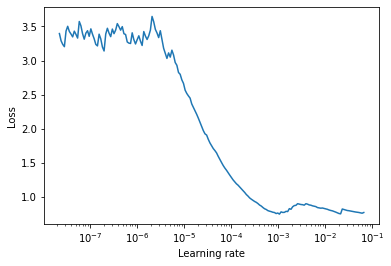

In [18]:
#lr_finder.reset()
lr_finder = CustomLRFinder(model, optimizer, criterion, device="cuda")

# seq dataloader / shuffel the dataloader
for refs, train_dl, val_dl in zip (refs_list, train_dls, valid_dls):
    custom_train_iter = CustomTrainIter(train_dl)
    custom_val_iter = CustomValIter(val_dl)
lr_finder.custom_range_test(custom_train_iter, curr_refs = refs, end_lr=end_lr, num_iter=200)
lr_finder.plot(suggest_lr= False)
lr_finder.reset()

## To see the intmediate feature

In [ ]:
feature_output1 = model.model.featuremap1.transpose(1,0).cpu()
feature_output2 = model.model.featuremap2.transpose(1,0).cpu()
#feature_output3 = model.model.featuremap3.transpose(1,0).cpu()
#feature_output4 = model.model.featuremap4.transpose(1,0).cpu()
#feature_output_fc = model.model.featuremapfc.transpose(1,0).cpu()
feature_output2.shape

In [ ]:
def feature_imshow(inp, title=None):
    
    """Imshow for Tensor."""
    
    inp = inp.detach().numpy().transpose((1, 2, 0))
    
    mean = np.array([0.5, 0.5, 0.5])
    
    std = np.array([0.5, 0.5, 0.5])
    
    inp = std * inp + mean
    
    inp = np.clip(inp, 0, 1)
    
    plt.imshow(inp)
    
    if title is not None:
        plt.title(title)
    
    plt.pause(0.001)  # pause a bit so that plots are updated

In [ ]:
out = torchvision.utils.make_grid(feature_output2)
feature_imshow(out)


## Training Config

In [19]:
num_epochs = 50

lr = 5e-4

min_lr_factor = 0.1
phases_ratio = [0.3, 0.2, 0.3, 0.2]

train_dl_idx = 0
valid_dl_idx = 1
test_dl_idx = 2

run_train = True

#optimizer = torch.optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, momentum=0.5)

criterion = nn.BCELoss()
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']

Total Train Iterations:  548
Total Train Iterations List:  [149, 230, 548]
Valid iterations per seq:  [49, 27, 106]


Train



Sequence:1, Seq Training Mean Loss: 0.6605570420322803, Seq Training Acc: 0.6411493288590604
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.635778742072023, Seq Training Acc: 0.6481481481481481
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.4092980721649134, Seq Training Acc: 0.8112224842767296
******************************************************************
Epoch:1, Epoch Training Loss Mean: 0.5110909938812256, Epoch Training Acc: 0.7408759124087592
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.657585367864492, Seq Valid Acc: 0.6256377551020408



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6655776732497745, Seq Valid Acc: 0.6076388888888888



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.4794213998149026, Seq Valid Acc: 0.8045400943396226
Epoch:1, Epoch Valid Mean Loss: 0.5550052523612976, Epoch Valid Acc: 0.7271634615384616
******************************************************************


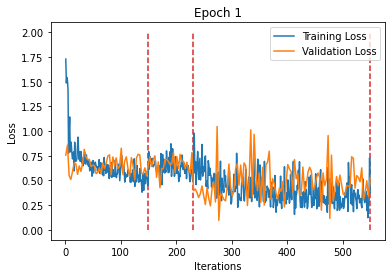

Train



Sequence:1, Seq Training Mean Loss: 0.5273748002196318, Seq Training Acc: 0.7445469798657718
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.5531833712701444, Seq Training Acc: 0.7272376543209876
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.34237082300227395, Seq Training Acc: 0.8515133647798742
******************************************************************
Epoch:2, Epoch Training Loss Mean: 0.42383328080177307, Epoch Training Acc: 0.8040602189781022
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.6232629570425773, Seq Valid Acc: 0.6460459183673469



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6446666916211446, Seq Valid Acc: 0.6168981481481481



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2999210627573841, Seq Valid Acc: 0.8800117924528302
Epoch:2, Epoch Valid Mean Loss: 0.43811821937561035, Epoch Valid Acc: 0.7779876373626373
******************************************************************


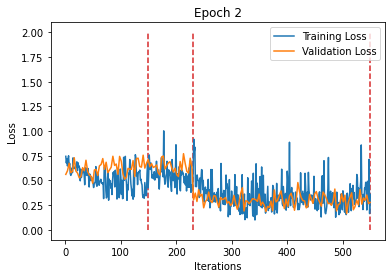

Train



Sequence:1, Seq Training Mean Loss: 0.4578616329087507, Seq Training Acc: 0.7818791946308725
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.5022178947189708, Seq Training Acc: 0.7638888888888888
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.31619186882140504, Seq Training Acc: 0.8687106918238994
******************************************************************
Epoch:3, Epoch Training Loss Mean: 0.38220810890197754, Epoch Training Acc: 0.8296076642335767
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5891822351484882, Seq Valid Acc: 0.7066326530612245



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7150834533903334, Seq Valid Acc: 0.5833333333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.35610954639203146, Seq Valid Acc: 0.839622641509434
Epoch:3, Epoch Valid Mean Loss: 0.472114235162735, Epoch Valid Acc: 0.7657967032967034
******************************************************************


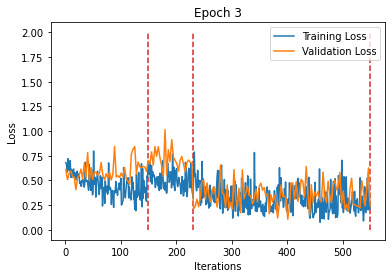

Train



Sequence:1, Seq Training Mean Loss: 0.44715789300483344, Seq Training Acc: 0.8003355704697986
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4911838350472627, Seq Training Acc: 0.7665895061728395
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2745133753420797, Seq Training Acc: 0.8822720125786163
******************************************************************
Epoch:4, Epoch Training Loss Mean: 0.35348114371299744, Epoch Training Acc: 0.8428946167883211
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 1.1162410609576168, Seq Valid Acc: 0.6301020408163265



******************************************************************
Sequence:2, Seq Valid Mean Loss: 1.1832281726377982, Seq Valid Acc: 0.5694444444444444



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2644465731562309, Seq Valid Acc: 0.8971108490566038
Epoch:4, Epoch Valid Mean Loss: 0.6300785541534424, Epoch Valid Acc: 0.776614010989011
******************************************************************


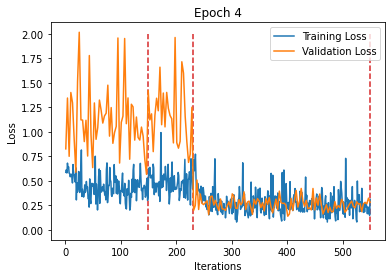

Train



Sequence:1, Seq Training Mean Loss: 0.4043689450161569, Seq Training Acc: 0.8246644295302014
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.44259303587454335, Seq Training Acc: 0.7978395061728395
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2567182699183248, Seq Training Acc: 0.8891509433962265
******************************************************************
Epoch:5, Epoch Training Loss Mean: 0.3243383765220642, Epoch Training Acc: 0.8581204379562044
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5733574269985666, Seq Valid Acc: 0.7283163265306123



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6561595344984973, Seq Valid Acc: 0.6493055555555556



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2935550230432232, Seq Valid Acc: 0.8808962264150944
Epoch:5, Epoch Valid Mean Loss: 0.4226793944835663, Epoch Valid Acc: 0.8054601648351648
******************************************************************


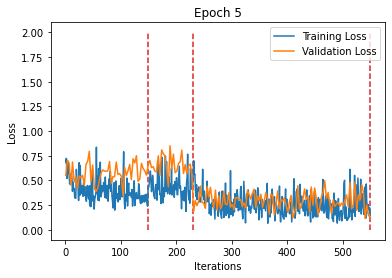

Train



Sequence:1, Seq Training Mean Loss: 0.41802109337893106, Seq Training Acc: 0.8171140939597316
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4360267713114067, Seq Training Acc: 0.7959104938271605
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.24553321005553944, Seq Training Acc: 0.9019261006289309
******************************************************************
Epoch:6, Epoch Training Loss Mean: 0.320589154958725, Epoch Training Acc: 0.8631957116788321
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4767425352213334, Seq Valid Acc: 0.7806122448979592



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6095656752586365, Seq Valid Acc: 0.6921296296296297



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.25892080942977147, Seq Valid Acc: 0.8929834905660378
Epoch:6, Epoch Valid Mean Loss: 0.3695838749408722, Epoch Valid Acc: 0.8329326923076923
******************************************************************


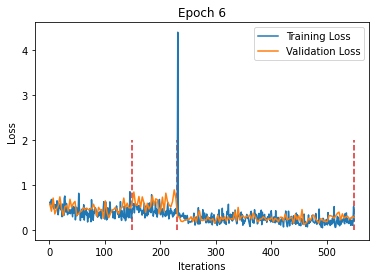

Train



Sequence:1, Seq Training Mean Loss: 0.3717034526619335, Seq Training Acc: 0.833263422818792
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.43311947657738203, Seq Training Acc: 0.8040123456790124
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2295419805970207, Seq Training Acc: 0.9015330188679245
******************************************************************
Epoch:7, Epoch Training Loss Mean: 0.29828622937202454, Epoch Training Acc: 0.8685561131386861
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4715865905187568, Seq Valid Acc: 0.795280612244898



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6050507150314473, Seq Valid Acc: 0.6759259259259259



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2933566076856739, Seq Valid Acc: 0.8873820754716981
Epoch:7, Epoch Valid Mean Loss: 0.3875819742679596, Epoch Valid Acc: 0.8312156593406593
******************************************************************


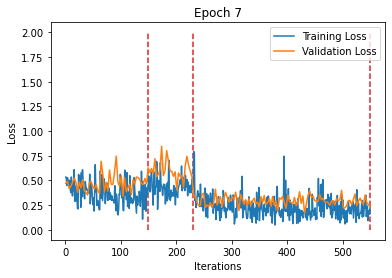

Train



Sequence:1, Seq Training Mean Loss: 0.36204997290100827, Seq Training Acc: 0.8460570469798657
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.414451065806695, Seq Training Acc: 0.8074845679012346
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2429397852634484, Seq Training Acc: 0.8978970125786163
******************************************************************
Epoch:8, Epoch Training Loss Mean: 0.30067673325538635, Epoch Training Acc: 0.8704379562043796
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.45561768753188, Seq Valid Acc: 0.8022959183673469



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6728901752719173, Seq Valid Acc: 0.6921296296296297



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2033500146331652, Seq Valid Acc: 0.9171580188679245
Epoch:8, Epoch Valid Mean Loss: 0.34092527627944946, Epoch Valid Acc: 0.8528502747252747
******************************************************************


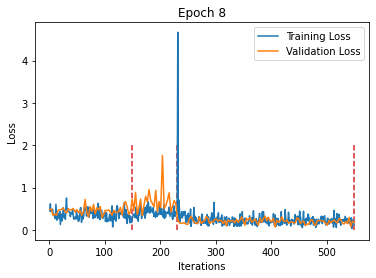

Train



Sequence:1, Seq Training Mean Loss: 0.34806791777978807, Seq Training Acc: 0.8500419463087249
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4008677894318545, Seq Training Acc: 0.8267746913580247
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.22381385519467997, Seq Training Acc: 0.9107704402515723
******************************************************************
Epoch:9, Epoch Training Loss Mean: 0.2837686538696289, Epoch Training Acc: 0.8818430656934306
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4264112917744384, Seq Valid Acc: 0.8067602040816326



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7167869729024393, Seq Valid Acc: 0.6516203703703703



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.26941670322755595, Seq Valid Acc: 0.8897405660377359
Epoch:9, Epoch Valid Mean Loss: 0.37805259227752686, Epoch Valid Acc: 0.8320741758241759
******************************************************************


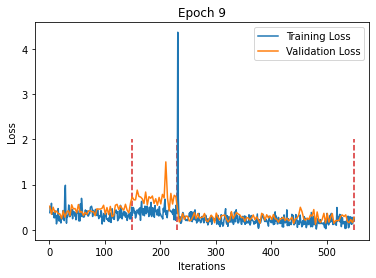

Train



Sequence:1, Seq Training Mean Loss: 0.3408555542962663, Seq Training Acc: 0.8525587248322147
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4146725507798018, Seq Training Acc: 0.8140432098765432
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.21760724634283557, Seq Training Acc: 0.9099842767295597
******************************************************************
Epoch:10, Epoch Training Loss Mean: 0.28024646639823914, Epoch Training Acc: 0.8801893248175182
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.5862097648941741, Seq Valid Acc: 0.7174744897959183



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.9850315429546215, Seq Valid Acc: 0.6134259259259259



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2263316995692703, Seq Valid Acc: 0.910377358490566
Epoch:10, Epoch Valid Mean Loss: 0.43577635288238525, Epoch Valid Acc: 0.8143887362637363
******************************************************************


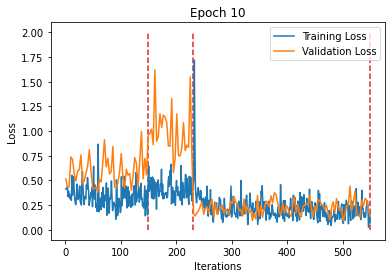

Train



Sequence:1, Seq Training Mean Loss: 0.3360522287403977, Seq Training Acc: 0.8550755033557047
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.40177823731928697, Seq Training Acc: 0.8155864197530864
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.20903157007019474, Seq Training Acc: 0.9130306603773585
******************************************************************
Epoch:11, Epoch Training Loss Mean: 0.2720581293106079, Epoch Training Acc: 0.8828695255474452
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.44428361921894305, Seq Valid Acc: 0.7908163265306123



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6757095169138025, Seq Valid Acc: 0.6701388888888888



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.26197579221905404, Seq Valid Acc: 0.8879716981132075
Epoch:11, Epoch Valid Mean Loss: 0.3724367618560791, Epoch Valid Acc: 0.8294986263736264
******************************************************************


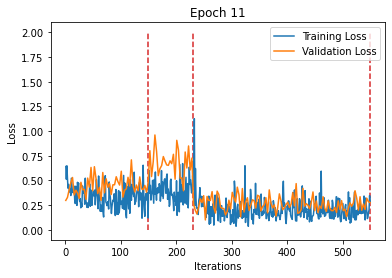

Train



Sequence:1, Seq Training Mean Loss: 0.3251164651557103, Seq Training Acc: 0.8613674496644296
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.38439800397113516, Seq Training Acc: 0.8233024691358025
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.19267884340230962, Seq Training Acc: 0.9208922955974843
******************************************************************
Epoch:12, Epoch Training Loss Mean: 0.25702640414237976, Epoch Training Acc: 0.8902828467153284
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.49771825330598013, Seq Valid Acc: 0.7723214285714286



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6029787891440921, Seq Valid Acc: 0.7037037037037037



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.19193257212217124, Seq Valid Acc: 0.921875
Epoch:12, Epoch Valid Mean Loss: 0.33523887395858765, Epoch Valid Acc: 0.8492445054945055
******************************************************************


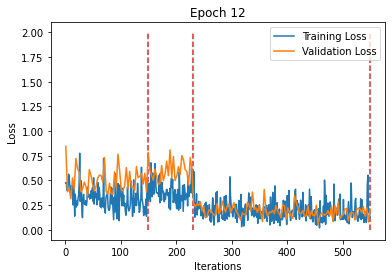

Train



Sequence:1, Seq Training Mean Loss: 0.33992562788044844, Seq Training Acc: 0.8596895973154363
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3909326876387184, Seq Training Acc: 0.8109567901234568
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.20491326410534247, Seq Training Acc: 0.9137185534591195
******************************************************************
Epoch:13, Epoch Training Loss Mean: 0.26911839842796326, Epoch Training Acc: 0.8838389598540146
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.41203026382290586, Seq Valid Acc: 0.8207908163265306



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7446685510653036, Seq Valid Acc: 0.6956018518518519



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.20743470378922965, Seq Valid Acc: 0.9136202830188679
Epoch:13, Epoch Valid Mean Loss: 0.3422176241874695, Epoch Valid Acc: 0.8562843406593407
******************************************************************


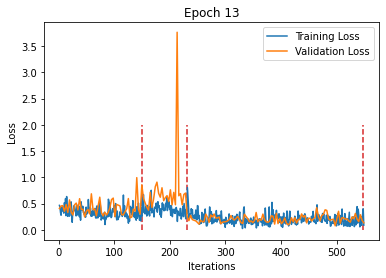

Train



Sequence:1, Seq Training Mean Loss: 0.32161316450610256, Seq Training Acc: 0.8630453020134228
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.39611829854088065, Seq Training Acc: 0.8252314814814815
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.2000013365170116, Seq Training Acc: 0.9194182389937107
******************************************************************
Epoch:14, Epoch Training Loss Mean: 0.2620554268360138, Epoch Training Acc: 0.8901687956204379
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.46824877967639844, Seq Valid Acc: 0.7882653061224489



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7742123305797577, Seq Valid Acc: 0.6550925925925926



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.27608354642706096, Seq Valid Acc: 0.890625
Epoch:14, Epoch Valid Mean Loss: 0.4017185568809509, Epoch Valid Acc: 0.828125
******************************************************************


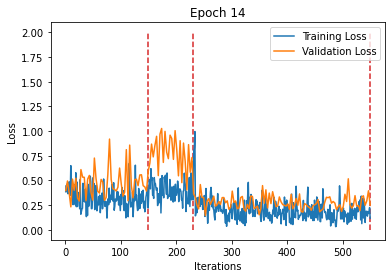

Train



Sequence:1, Seq Training Mean Loss: 0.3280378724104606, Seq Training Acc: 0.8598993288590604
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3852068215240667, Seq Training Acc: 0.8263888888888888
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.19259474427679424, Seq Training Acc: 0.9209905660377359
******************************************************************
Epoch:15, Epoch Training Loss Mean: 0.2578914761543274, Epoch Training Acc: 0.890396897810219
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4162868194434108, Seq Valid Acc: 0.8099489795918368



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6063682646663101, Seq Valid Acc: 0.7071759259259259



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1824717828828209, Seq Valid Acc: 0.9262971698113207
Epoch:15, Epoch Valid Mean Loss: 0.3083077371120453, Epoch Valid Acc: 0.8624656593406593
******************************************************************


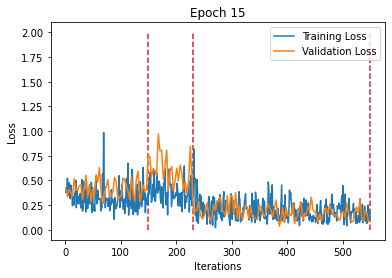

Train



Sequence:1, Seq Training Mean Loss: 0.3199030725947963, Seq Training Acc: 0.8657718120805369
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.4036782244105398, Seq Training Acc: 0.8252314814814815
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.20444333255173838, Seq Training Acc: 0.9198113207547169
******************************************************************
Epoch:16, Epoch Training Loss Mean: 0.26528552174568176, Epoch Training Acc: 0.8911382299270073
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4154396385562663, Seq Valid Acc: 0.8207908163265306



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6796498563554552, Seq Valid Acc: 0.6898148148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.26591434660104085, Seq Valid Acc: 0.8811910377358491
Epoch:16, Epoch Valid Mean Loss: 0.36754947900772095, Epoch Valid Acc: 0.8365384615384616
******************************************************************


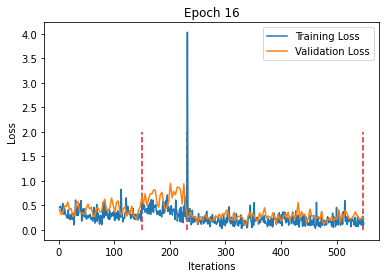

Train



Sequence:1, Seq Training Mean Loss: 0.33286149159773887, Seq Training Acc: 0.8596895973154363
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3760091449007576, Seq Training Acc: 0.8260030864197531
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.19886116517133684, Seq Training Acc: 0.9195165094339622
******************************************************************
Epoch:17, Epoch Training Loss Mean: 0.26147985458374023, Epoch Training Acc: 0.8894274635036497
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.38964574860066786, Seq Valid Acc: 0.8144132653061225



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6883761220508151, Seq Valid Acc: 0.6782407407407407



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2187818002728921, Seq Valid Acc: 0.9112617924528302
Epoch:17, Epoch Valid Mean Loss: 0.33444875478744507, Epoch Valid Acc: 0.8506181318681318
******************************************************************


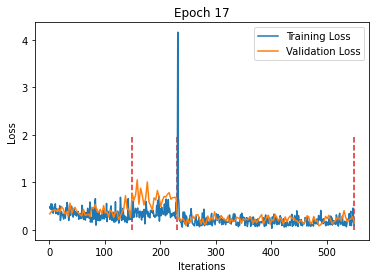

Train



Sequence:1, Seq Training Mean Loss: 0.32252857149047337, Seq Training Acc: 0.8634647651006712
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3863123381211434, Seq Training Acc: 0.8267746913580247
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.20179308057065654, Seq Training Acc: 0.9207940251572327
******************************************************************
Epoch:18, Epoch Training Loss Mean: 0.2618946433067322, Epoch Training Acc: 0.891309306569343
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3912499449690994, Seq Valid Acc: 0.826530612244898



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6139103107982211, Seq Valid Acc: 0.6828703703703703



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.19368642846227818, Seq Valid Acc: 0.9268867924528302
Epoch:18, Epoch Valid Mean Loss: 0.30921751260757446, Epoch Valid Acc: 0.8636675824175825
******************************************************************


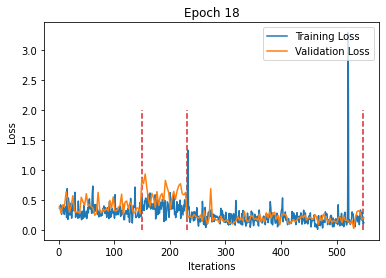

Train



Sequence:1, Seq Training Mean Loss: 0.2919128615434138, Seq Training Acc: 0.878984899328859
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.37759433484371796, Seq Training Acc: 0.8283179012345679
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.18118691599031664, Seq Training Acc: 0.9248231132075472
******************************************************************
Epoch:19, Epoch Training Loss Mean: 0.24032409489154816, Epoch Training Acc: 0.8980953467153284
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.38912884678159443, Seq Valid Acc: 0.8233418367346939



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.7421399542578945, Seq Valid Acc: 0.6944444444444444



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.21526010028736772, Seq Valid Acc: 0.9127358490566038
Epoch:19, Epoch Valid Mean Loss: 0.3402343988418579, Epoch Valid Acc: 0.8562843406593407
******************************************************************


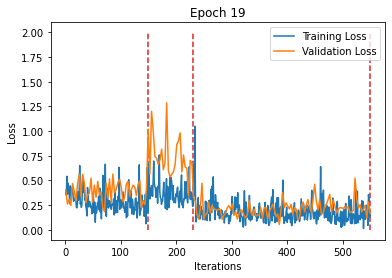

Train



Sequence:1, Seq Training Mean Loss: 0.31176344390283495, Seq Training Acc: 0.8726929530201343
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.38810942901505363, Seq Training Acc: 0.8260030864197531
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.17330552290234738, Seq Training Acc: 0.9244300314465409
******************************************************************
Epoch:20, Epoch Training Loss Mean: 0.2427021563053131, Epoch Training Acc: 0.8958143248175182
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3569142420072945, Seq Valid Acc: 0.8360969387755102



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6707888333885758, Seq Valid Acc: 0.7013888888888888



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.17799345748323314, Seq Valid Acc: 0.9307193396226415
Epoch:20, Epoch Valid Mean Loss: 0.29927146434783936, Epoch Valid Acc: 0.8712225274725275
******************************************************************


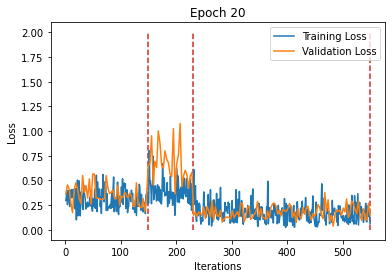

Train



Sequence:1, Seq Training Mean Loss: 0.30054635204524804, Seq Training Acc: 0.8689177852348994
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3654561769447209, Seq Training Acc: 0.8383487654320988
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.17741149332690634, Seq Training Acc: 0.9276729559748428
******************************************************************
Epoch:21, Epoch Training Loss Mean: 0.23868653178215027, Epoch Training Acc: 0.8984945255474452
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3862243939419182, Seq Valid Acc: 0.8380102040816326



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.638609316613939, Seq Valid Acc: 0.6655092592592593



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.2591253680721769, Seq Valid Acc: 0.9215801886792453
Epoch:21, Epoch Valid Mean Loss: 0.3496414124965668, Epoch Valid Acc: 0.861092032967033
******************************************************************


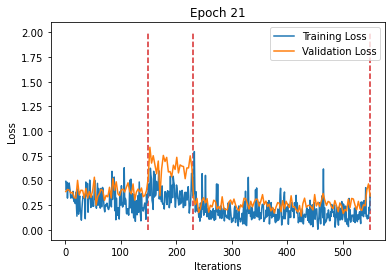

Train



Sequence:1, Seq Training Mean Loss: 0.2901673115439863, Seq Training Acc: 0.8787751677852349
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3542088134053313, Seq Training Acc: 0.8414351851851852
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.16669270448948978, Seq Training Acc: 0.9314072327044025
******************************************************************
Epoch:22, Epoch Training Loss Mean: 0.22798196971416473, Epoch Training Acc: 0.9037979014598541
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3063995646578925, Seq Valid Acc: 0.8660714285714286



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5320493788630875, Seq Valid Acc: 0.7673611111111112



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.16102291917744674, Seq Valid Acc: 0.9380896226415094
Epoch:22, Epoch Valid Mean Loss: 0.2552051842212677, Epoch Valid Acc: 0.8933722527472527
******************************************************************


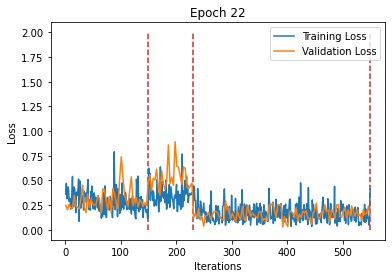

Train



Sequence:1, Seq Training Mean Loss: 0.30579308645437225, Seq Training Acc: 0.8666107382550335
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3583178017978315, Seq Training Acc: 0.8360339506172839
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.16707589558132416, Seq Training Acc: 0.9279677672955975
******************************************************************
Epoch:23, Epoch Training Loss Mean: 0.2330603003501892, Epoch Training Acc: 0.8976961678832117
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3190116851913686, Seq Valid Acc: 0.8590561224489796



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5180335894778922, Seq Valid Acc: 0.7534722222222222



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.19555693344687516, Seq Valid Acc: 0.9230542452830188
Epoch:23, Epoch Valid Mean Loss: 0.27663466334342957, Epoch Valid Acc: 0.8806662087912088
******************************************************************


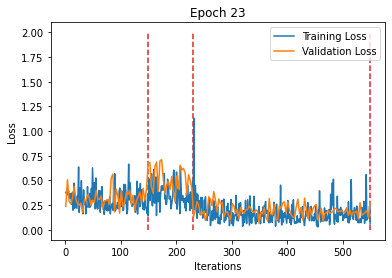

Train



Sequence:1, Seq Training Mean Loss: 0.29194974299245235, Seq Training Acc: 0.8768875838926175
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.36631703928664877, Seq Training Acc: 0.8240740740740741
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.16844642442305507, Seq Training Acc: 0.9263954402515723
******************************************************************
Epoch:24, Epoch Training Loss Mean: 0.23127400875091553, Epoch Training Acc: 0.8978102189781022
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.4250876441293833, Seq Valid Acc: 0.8169642857142857



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.48125394847657943, Seq Valid Acc: 0.7905092592592593



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.22501853340358105, Seq Valid Acc: 0.917747641509434
Epoch:24, Epoch Valid Mean Loss: 0.3168962299823761, Epoch Valid Acc: 0.8717376373626373
******************************************************************


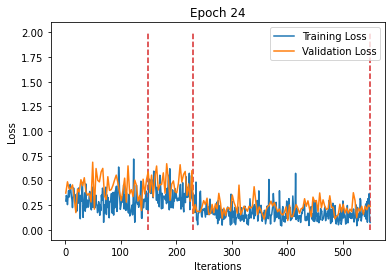

Train



Sequence:1, Seq Training Mean Loss: 0.2870616305294453, Seq Training Acc: 0.8835989932885906
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.35566379497816536, Seq Training Acc: 0.8449074074074074
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.16896533151303636, Seq Training Acc: 0.9298349056603774
******************************************************************
Epoch:25, Epoch Training Loss Mean: 0.22867140173912048, Epoch Training Acc: 0.9047103102189781
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.33467889744408275, Seq Valid Acc: 0.8584183673469388



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5276992155445946, Seq Valid Acc: 0.7534722222222222



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.16506105264262208, Seq Valid Acc: 0.9392688679245284
Epoch:25, Epoch Valid Mean Loss: 0.2645253539085388, Epoch Valid Acc: 0.8899381868131868
******************************************************************


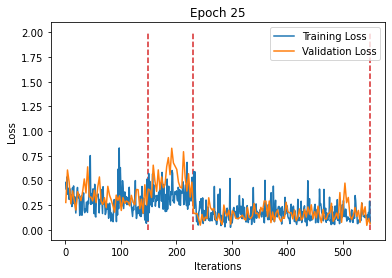

Train



Sequence:1, Seq Training Mean Loss: 0.2788879386330611, Seq Training Acc: 0.8819211409395973
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.35076969310089395, Seq Training Acc: 0.8368055555555556
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.16913614772939645, Seq Training Acc: 0.9304245283018868
******************************************************************
Epoch:26, Epoch Training Loss Mean: 0.22582469880580902, Epoch Training Acc: 0.9033987226277372
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.320813994018399, Seq Valid Acc: 0.8679846938775511



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.507123718659083, Seq Valid Acc: 0.7847222222222222



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.17598561888103778, Seq Valid Acc: 0.9351415094339622
Epoch:26, Epoch Valid Mean Loss: 0.2641027569770813, Epoch Valid Acc: 0.8947458791208791
******************************************************************


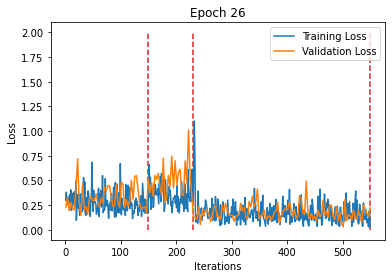

Train



Sequence:1, Seq Training Mean Loss: 0.2763301982175584, Seq Training Acc: 0.885486577181208
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.36747192011939156, Seq Training Acc: 0.8287037037037037
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1683695778168691, Seq Training Acc: 0.9311124213836478
******************************************************************
Epoch:27, Epoch Training Loss Mean: 0.22715319693088531, Epoch Training Acc: 0.903569799270073
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.32243447066569814, Seq Valid Acc: 0.8596938775510204



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.47163845543508176, Seq Valid Acc: 0.7719907407407407



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.20690106874648131, Seq Valid Acc: 0.9221698113207547
Epoch:27, Epoch Valid Mean Loss: 0.27728044986724854, Epoch Valid Acc: 0.883070054945055
******************************************************************


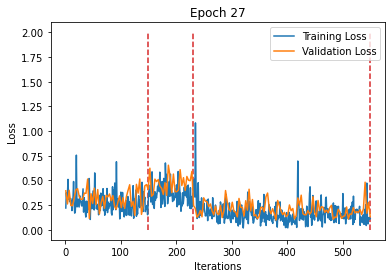

Train



Sequence:1, Seq Training Mean Loss: 0.2660015617441011, Seq Training Acc: 0.8913590604026845
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3468349149197708, Seq Training Acc: 0.8506944444444444
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15785300270683547, Seq Training Acc: 0.9314072327044025
******************************************************************
Epoch:28, Epoch Training Loss Mean: 0.2151918262243271, Epoch Training Acc: 0.9085880474452555
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.31089691011881343, Seq Valid Acc: 0.8679846938775511



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.49103496582419787, Seq Valid Acc: 0.7731481481481481



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.14963444255573569, Seq Valid Acc: 0.9454599056603774
Epoch:28, Epoch Valid Mean Loss: 0.2436985969543457, Epoch Valid Acc: 0.8990384615384616
******************************************************************


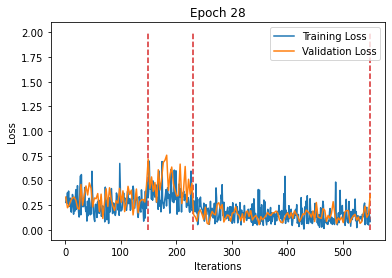

Train



Sequence:1, Seq Training Mean Loss: 0.28131409269451296, Seq Training Acc: 0.8898909395973155
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.34044216150118983, Seq Training Acc: 0.8491512345679012
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15382647744538086, Seq Training Acc: 0.936124213836478
******************************************************************
Epoch:29, Epoch Training Loss Mean: 0.21607379615306854, Epoch Training Acc: 0.9106979927007299
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.302668177655765, Seq Valid Acc: 0.8781887755102041



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5095283157295651, Seq Valid Acc: 0.7754629629629629



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.17076807384783366, Seq Valid Acc: 0.9316037735849056
Epoch:29, Epoch Valid Mean Loss: 0.25653529167175293, Epoch Valid Acc: 0.8940590659340659
******************************************************************


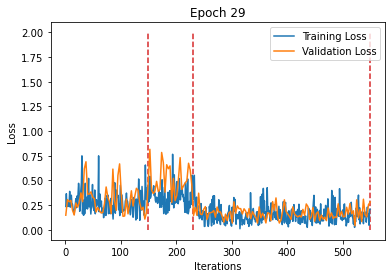

Train



Sequence:1, Seq Training Mean Loss: 0.2759146472351663, Seq Training Acc: 0.881501677852349
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.33047140417275606, Seq Training Acc: 0.8468364197530864
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.15463817446439895, Seq Training Acc: 0.9338639937106918
******************************************************************
Epoch:30, Epoch Training Loss Mean: 0.2136029452085495, Epoch Training Acc: 0.9067632299270073
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.30909744604509704, Seq Valid Acc: 0.8628826530612245



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.45850435340846024, Seq Valid Acc: 0.7789351851851852



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1637194945283656, Seq Valid Acc: 0.9407429245283019
Epoch:30, Epoch Valid Mean Loss: 0.24659155309200287, Epoch Valid Acc: 0.8957760989010989
******************************************************************


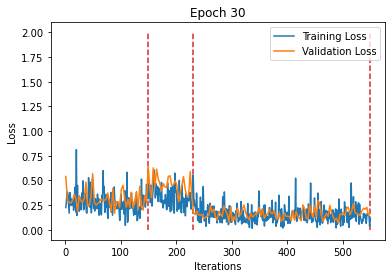

Train



Sequence:1, Seq Training Mean Loss: 0.27222055296769876, Seq Training Acc: 0.885486577181208
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3408025661368429, Seq Training Acc: 0.8499228395061729
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.1515615744071093, Seq Training Acc: 0.9377948113207547
******************************************************************
Epoch:31, Epoch Training Loss Mean: 0.21234023571014404, Epoch Training Acc: 0.9105839416058394
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3181246497801372, Seq Valid Acc: 0.8654336734693877



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4588838109263667, Seq Valid Acc: 0.7835648148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.16266699792500935, Seq Valid Acc: 0.9354363207547169
Epoch:31, Epoch Valid Mean Loss: 0.24846524000167847, Epoch Valid Acc: 0.8940590659340659
******************************************************************


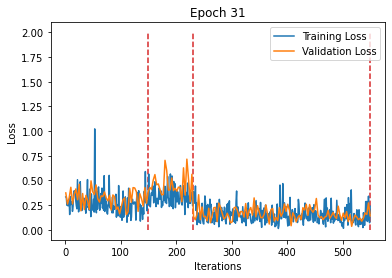

Train



Sequence:1, Seq Training Mean Loss: 0.27214455724562575, Seq Training Acc: 0.8852768456375839
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3154762836150181, Seq Training Acc: 0.8657407407407407
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.14580625074230275, Seq Training Acc: 0.9382861635220126
******************************************************************
Epoch:32, Epoch Training Loss Mean: 0.20523633062839508, Epoch Training Acc: 0.9131500912408759
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.29936766624450684, Seq Valid Acc: 0.8756377551020408



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.44047184067743794, Seq Valid Acc: 0.7916666666666666



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.16873498004421872, Seq Valid Acc: 0.941627358490566
Epoch:32, Epoch Valid Mean Loss: 0.24421793222427368, Epoch Valid Acc: 0.901614010989011
******************************************************************


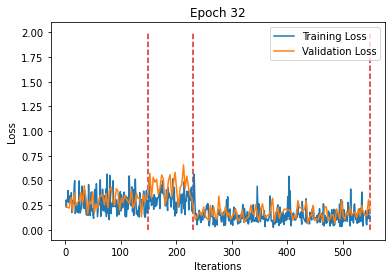

Train



Sequence:1, Seq Training Mean Loss: 0.2521261011794109, Seq Training Acc: 0.8949244966442953
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.31822629935211605, Seq Training Acc: 0.8641975308641975
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.13827545302715036, Seq Training Acc: 0.9410377358490566
******************************************************************
Epoch:33, Epoch Training Loss Mean: 0.19582976400852203, Epoch Training Acc: 0.9171418795620438
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2868413230290218, Seq Valid Acc: 0.8896683673469388



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.49966533206127306, Seq Valid Acc: 0.7766203703703703



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.16207642772428268, Seq Valid Acc: 0.9336674528301887
Epoch:33, Epoch Valid Mean Loss: 0.2457488626241684, Epoch Valid Acc: 0.8985233516483516
******************************************************************


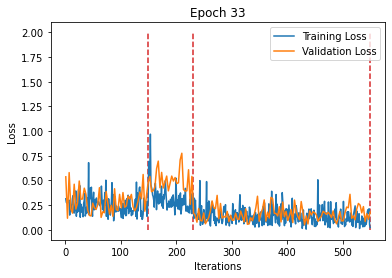

Train



Sequence:1, Seq Training Mean Loss: 0.25149741308801127, Seq Training Acc: 0.8991191275167785
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.3084957115812066, Seq Training Acc: 0.8572530864197531
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.13609521469956487, Seq Training Acc: 0.9428066037735849
******************************************************************
Epoch:34, Epoch Training Loss Mean: 0.1929553747177124, Epoch Training Acc: 0.918282390510949
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3107974891151701, Seq Valid Acc: 0.8660714285714286



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.6298436919848124, Seq Valid Acc: 0.7303240740740741



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1628582519742678, Seq Valid Acc: 0.9363207547169812
Epoch:34, Epoch Valid Mean Loss: 0.2719661295413971, Epoch Valid Acc: 0.8868475274725275
******************************************************************


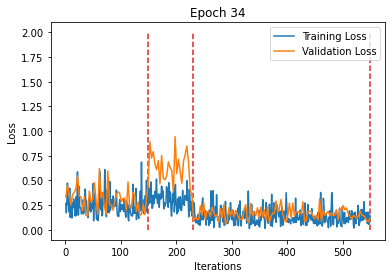

Train



Sequence:1, Seq Training Mean Loss: 0.2355869785451249, Seq Training Acc: 0.9039429530201343
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.30728586735548796, Seq Training Acc: 0.8595679012345679
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.13617684442620231, Seq Training Acc: 0.9432979559748428
******************************************************************
Epoch:35, Epoch Training Loss Mean: 0.1884978860616684, Epoch Training Acc: 0.9202212591240876
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2972461199577974, Seq Valid Acc: 0.8756377551020408



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4997024138768514, Seq Valid Acc: 0.7569444444444444



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.14344476959404517, Seq Valid Acc: 0.9481132075471698
Epoch:35, Epoch Valid Mean Loss: 0.23770421743392944, Epoch Valid Acc: 0.9002403846153846
******************************************************************


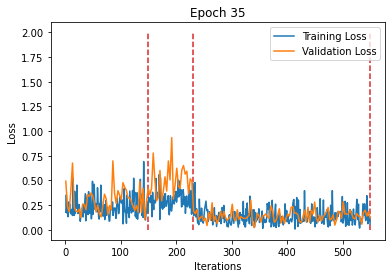

Train



Sequence:1, Seq Training Mean Loss: 0.24639178787501867, Seq Training Acc: 0.8999580536912751
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.335386885812989, Seq Training Acc: 0.8503086419753086
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12476507172503937, Seq Training Acc: 0.9465408805031447
******************************************************************
Epoch:36, Epoch Training Loss Mean: 0.18896716833114624, Epoch Training Acc: 0.919651003649635
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.30257078473057064, Seq Valid Acc: 0.8692602040816326



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.44430004832921205, Seq Valid Acc: 0.7962962962962963



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1696753621031091, Seq Valid Acc: 0.9395636792452831
Epoch:36, Epoch Valid Mean Loss: 0.24619591236114502, Epoch Valid Acc: 0.8993818681318682
******************************************************************


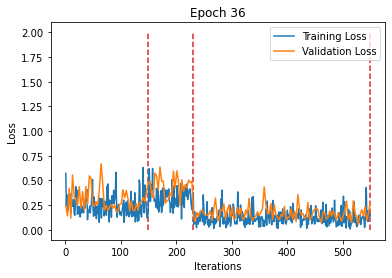

Train



Sequence:1, Seq Training Mean Loss: 0.25598509832216587, Seq Training Acc: 0.899748322147651
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.28993318791006817, Seq Training Acc: 0.8684413580246914
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12397317661546499, Seq Training Acc: 0.9469339622641509
******************************************************************
Epoch:37, Epoch Training Loss Mean: 0.18439751863479614, Epoch Training Acc: 0.9225022810218978
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.30662520184200637, Seq Valid Acc: 0.8718112244897959



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5809724651001118, Seq Valid Acc: 0.7835648148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.14423327513460843, Seq Valid Acc: 0.9401533018867925
Epoch:37, Epoch Valid Mean Loss: 0.2527451515197754, Epoch Valid Acc: 0.8985233516483516
******************************************************************


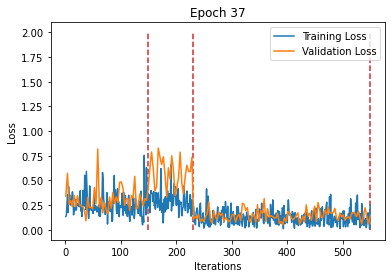

Train



Sequence:1, Seq Training Mean Loss: 0.2570678805744888, Seq Training Acc: 0.8980704697986577
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.30488287363155386, Seq Training Acc: 0.8707561728395061
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12511869269253323, Seq Training Acc: 0.9454599056603774
******************************************************************
Epoch:38, Epoch Training Loss Mean: 0.1875663697719574, Epoch Training Acc: 0.9215328467153284
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.25608709515357503, Seq Valid Acc: 0.8928571428571429



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.40848732822471195, Seq Valid Acc: 0.8125



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.15107171894666158, Seq Valid Acc: 0.9348466981132075
Epoch:38, Epoch Valid Mean Loss: 0.21753311157226562, Epoch Valid Acc: 0.9053914835164835
******************************************************************


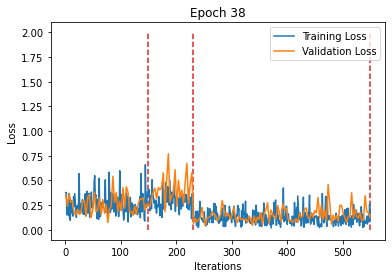

Train



Sequence:1, Seq Training Mean Loss: 0.2426093566737719, Seq Training Acc: 0.8984899328859061
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.33163248204890594, Seq Training Acc: 0.8560956790123457
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12055339317903532, Seq Training Acc: 0.9472287735849056
******************************************************************
Epoch:39, Epoch Training Loss Mean: 0.18493980169296265, Epoch Training Acc: 0.9205063868613139
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.29404945732379445, Seq Valid Acc: 0.8775510204081632



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4554814723906694, Seq Valid Acc: 0.7835648148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1483604998661662, Seq Valid Acc: 0.9357311320754716
Epoch:39, Epoch Valid Mean Loss: 0.23314635455608368, Epoch Valid Acc: 0.8974931318681318
******************************************************************


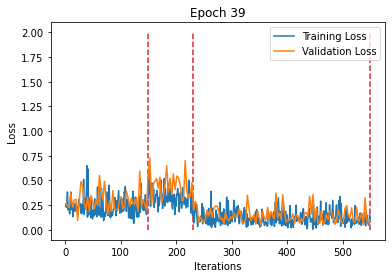

Train



Sequence:1, Seq Training Mean Loss: 0.24776709009736977, Seq Training Acc: 0.8974412751677853
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.29731645435094833, Seq Training Acc: 0.8603395061728395
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11427921710137583, Seq Training Acc: 0.9507665094339622
******************************************************************
Epoch:40, Epoch Training Loss Mean: 0.17762905359268188, Epoch Training Acc: 0.9229014598540146
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2638975728531273, Seq Valid Acc: 0.8896683673469388



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5198949840333726, Seq Valid Acc: 0.7523148148148148



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1634847865492668, Seq Valid Acc: 0.9316037735849056
Epoch:40, Epoch Valid Mean Loss: 0.24339303374290466, Epoch Valid Acc: 0.8937156593406593
******************************************************************


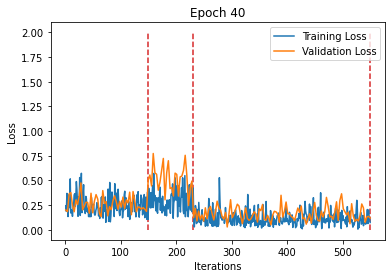

Train



Sequence:1, Seq Training Mean Loss: 0.24743386848060878, Seq Training Acc: 0.9049916107382551
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.28232278408091743, Seq Training Acc: 0.875
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.12939202941298109, Seq Training Acc: 0.9430031446540881
******************************************************************
Epoch:41, Epoch Training Loss Mean: 0.18409207463264465, Epoch Training Acc: 0.9226163321167883
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2695336390514763, Seq Valid Acc: 0.8934948979591837



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4334345382672769, Seq Valid Acc: 0.8032407407407407



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.13563616925253058, Seq Valid Acc: 0.9516509433962265
Epoch:41, Epoch Valid Mean Loss: 0.2158643752336502, Epoch Valid Acc: 0.9139766483516484
******************************************************************


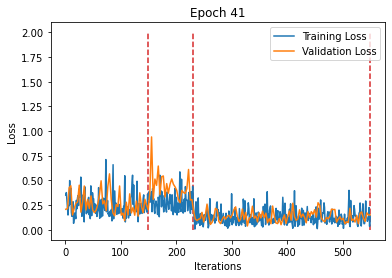

Train



Sequence:1, Seq Training Mean Loss: 0.22962320085939944, Seq Training Acc: 0.9091862416107382
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.29798245264424217, Seq Training Acc: 0.8688271604938271
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11910089237158591, Seq Training Acc: 0.9486045597484277
******************************************************************
Epoch:42, Epoch Training Loss Mean: 0.17559218406677246, Epoch Training Acc: 0.926094890510949
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.28183294452574786, Seq Valid Acc: 0.8775510204081632



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.46249235780150805, Seq Valid Acc: 0.7951388888888888



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.12872023232070343, Seq Valid Acc: 0.9460495283018868
Epoch:42, Epoch Valid Mean Loss: 0.21945852041244507, Epoch Valid Acc: 0.9052197802197802
******************************************************************


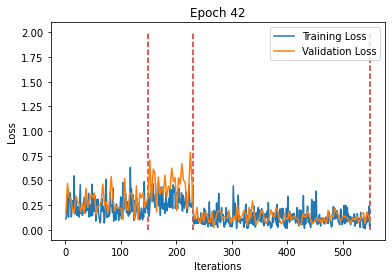

Train



Sequence:1, Seq Training Mean Loss: 0.22773399194014954, Seq Training Acc: 0.9066694630872483
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2768971022264457, Seq Training Acc: 0.878858024691358
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11565276026819488, Seq Training Acc: 0.9500786163522013
******************************************************************
Epoch:43, Epoch Training Loss Mean: 0.16996097564697266, Epoch Training Acc: 0.9277486313868614
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2956823305207856, Seq Valid Acc: 0.8775510204081632



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.47950171651663603, Seq Valid Acc: 0.7858796296296297



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.13035053830101806, Seq Valid Acc: 0.9495872641509434
Epoch:43, Epoch Valid Mean Loss: 0.2266600877046585, Epoch Valid Acc: 0.9059065934065934
******************************************************************


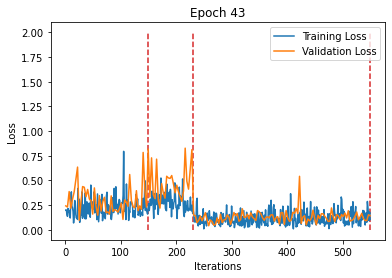

Train



Sequence:1, Seq Training Mean Loss: 0.22500565288050864, Seq Training Acc: 0.9056208053691275
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2708029474741147, Seq Training Acc: 0.8722993827160493
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11016290960540562, Seq Training Acc: 0.9522405660377359
******************************************************************
Epoch:44, Epoch Training Loss Mean: 0.16513264179229736, Epoch Training Acc: 0.9277486313868614
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.3008834622344192, Seq Valid Acc: 0.8826530612244898



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.4841528126487025, Seq Valid Acc: 0.7951388888888888



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1291425446364677, Seq Valid Acc: 0.9442806603773585
Epoch:44, Epoch Valid Mean Loss: 0.22804683446884155, Epoch Valid Acc: 0.9055631868131868
******************************************************************


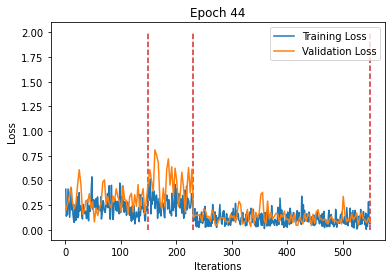

Train



Sequence:1, Seq Training Mean Loss: 0.23714281943620452, Seq Training Acc: 0.9041526845637584
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.27451268482355423, Seq Training Acc: 0.8753858024691358
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10823359097201822, Seq Training Acc: 0.952437106918239
******************************************************************
Epoch:45, Epoch Training Loss Mean: 0.1678614765405655, Epoch Training Acc: 0.9279197080291971
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.28914402379673354, Seq Valid Acc: 0.8737244897959183



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.44718424092840264, Seq Valid Acc: 0.8067129629629629



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.12498760666206198, Seq Valid Acc: 0.9522405660377359
Epoch:45, Epoch Valid Mean Loss: 0.2169819474220276, Epoch Valid Acc: 0.9095123626373627
******************************************************************


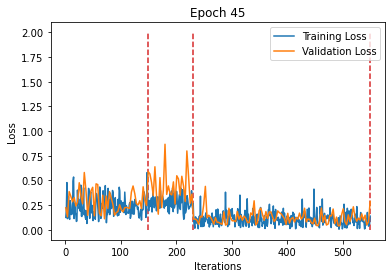

Train



Sequence:1, Seq Training Mean Loss: 0.2115383049185644, Seq Training Acc: 0.9142197986577181
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.27764345714707434, Seq Training Acc: 0.8692129629629629
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10719758591251506, Seq Training Acc: 0.9522405660377359
******************************************************************
Epoch:46, Epoch Training Loss Mean: 0.16076123714447021, Epoch Training Acc: 0.9296304744525548
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.28702495855336285, Seq Valid Acc: 0.8813775510204082



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5174435117730388, Seq Valid Acc: 0.7928240740740741



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.12061586137861013, Seq Valid Acc: 0.9498820754716981
Epoch:46, Epoch Valid Mean Loss: 0.22428835928440094, Epoch Valid Acc: 0.9081387362637363
******************************************************************


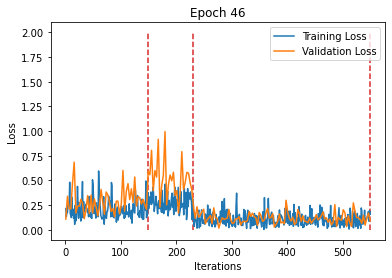

Train



Sequence:1, Seq Training Mean Loss: 0.2271445265302322, Seq Training Acc: 0.9066694630872483
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.2839639061762963, Seq Training Acc: 0.8703703703703703
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.11093087254367394, Seq Training Acc: 0.9514544025157232
******************************************************************
Epoch:47, Epoch Training Loss Mean: 0.16810515522956848, Epoch Training Acc: 0.9272924270072993
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2759124708114838, Seq Valid Acc: 0.8832908163265306



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5079723905633997, Seq Valid Acc: 0.7893518518518519



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.1247793926312676, Seq Valid Acc: 0.9522405660377359
Epoch:47, Epoch Valid Mean Loss: 0.22231636941432953, Epoch Valid Acc: 0.9095123626373627
******************************************************************


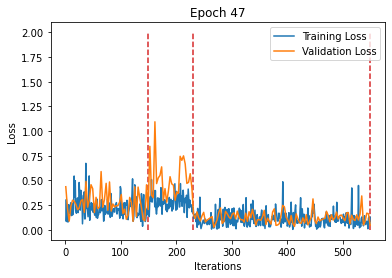

Train



Sequence:1, Seq Training Mean Loss: 0.20877152178811548, Seq Training Acc: 0.9150587248322147
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.29124721351229116, Seq Training Acc: 0.8707561728395061
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10837311746622875, Seq Training Acc: 0.9555817610062893
******************************************************************
Epoch:48, Epoch Training Loss Mean: 0.16270188987255096, Epoch Training Acc: 0.9320255474452555
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2882537373474666, Seq Valid Acc: 0.8762755102040817



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5546580928343313, Seq Valid Acc: 0.7731481481481481



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.12852660315287, Seq Valid Acc: 0.948997641509434
Epoch:48, Epoch Valid Mean Loss: 0.23474738001823425, Epoch Valid Acc: 0.9033310439560439
******************************************************************


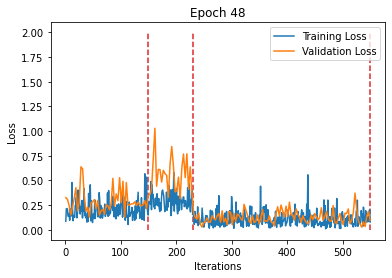

Train



Sequence:1, Seq Training Mean Loss: 0.22384434953431956, Seq Training Acc: 0.9138003355704698
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.27304941875699124, Seq Training Acc: 0.8726851851851852
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10360807321567393, Seq Training Acc: 0.9544025157232704
******************************************************************
Epoch:49, Epoch Training Loss Mean: 0.1613452136516571, Epoch Training Acc: 0.9312842153284672
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.2734311110511118, Seq Valid Acc: 0.8896683673469388



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5636225177182091, Seq Valid Acc: 0.7488425925925926



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.14130531799680782, Seq Valid Acc: 0.9410377358490566
Epoch:49, Epoch Valid Mean Loss: 0.2395291030406952, Epoch Valid Acc: 0.898695054945055
******************************************************************


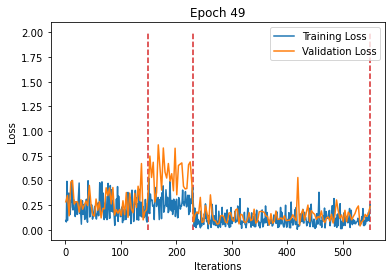

Train



Sequence:1, Seq Training Mean Loss: 0.2296080715304253, Seq Training Acc: 0.9089765100671141
******************************************************************



Sequence:2, Seq Training Mean Loss: 0.29189293592432397, Seq Training Acc: 0.8622685185185185
******************************************************************



Sequence:3, Seq Training Mean Loss: 0.10561916290389949, Seq Training Acc: 0.9553852201257862
******************************************************************
Epoch:50, Epoch Training Loss Mean: 0.16686464846134186, Epoch Training Acc: 0.929003193430657
******************************************************************
Validation



******************************************************************
Sequence:1, Seq Valid Mean Loss: 0.29018131126554647, Seq Valid Acc: 0.8794642857142857



******************************************************************
Sequence:2, Seq Valid Mean Loss: 0.5070581988052085, Seq Valid Acc: 0.7708333333333334



******************************************************************
Sequence:3, Seq Valid Mean Loss: 0.12492206365854111, Seq Valid Acc: 0.9492924528301887
Epoch:50, Epoch Valid Mean Loss: 0.2261054664850235, Epoch Valid Acc: 0.9040178571428571
******************************************************************


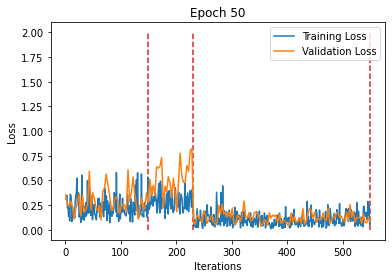


Save Model


NameError: name 'net_path' is not defined

In [20]:
if run_train:
    writer = SummaryWriter('runs/008_ResNet50_1stripe_5e-4')
    max_iter_per_seq = 600
    # 训练迭代总步数
    num_train_iter_per_epoch = 0
    num_train_iterations = [] # For plot parting line
    num_train_iterations_per_dl = [max_iter_per_seq if len(dl)>= max_iter_per_seq else len(dl) for dl in train_dls]
    for seq_dataloaders in dataloaders:
        if len(seq_dataloaders[train_dl_idx]) <= max_iter_per_seq:
            num_train_iter_per_epoch += len(seq_dataloaders[train_dl_idx])
        else:
            num_train_iter_per_epoch += max_iter_per_seq
        num_train_iterations.append(num_train_iter_per_epoch)
    print("Total Train Iterations: ",num_train_iter_per_epoch)
    print("Total Train Iterations List: ",num_train_iterations)
        
    # 训练迭代总步数为验证迭代总步数的3倍
    num_val_iterations = [int(number / 3) for number in num_train_iterations]
    num_val_iter_per_epoch = num_val_iterations[-1]
    
    # iterations in every seq
    num_val_iter_per_seq = []
    num_val_iter_per_seq.append(num_val_iterations[0])
    for i in range(len(num_val_iterations)-1):
        diff = num_val_iterations[i+1] - num_val_iterations[i] # The latter minus the former
        num_val_iter_per_seq.append(diff)
        
    print("Valid iterations per seq: ",num_val_iter_per_seq)
        
    optimizer = torch.optim.Adam(model.parameters(),lr=lr,eps=1e-08)

    scheduler = OneCycleLR(optimizer, num_train_iter_per_epoch, num_epochs, min_lr_factor=min_lr_factor)
    scheduler.step(epoch=0)
    
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.
    loss_min = 0.
    
    for epoch in tqdm(range(1,num_epochs+1)):

        print('Train')

        model.train()
        
        running_corrects = 0

        train_loss_array = np.zeros(num_train_iter_per_epoch, dtype=np.single)

        # mse_y = torch.zeros(batch_sizes[0]//2).to(device)
        
        i = 0
        seq_idx = 1
        for (refs, train_dl, max_num) in zip(refs_list, train_dls, num_train_iterations_per_dl):
            # obtain the refs in every seq
            
            curr_train_dl = train_dl

            curr_refs = refs.float().to(device)

            # Training
            dl_iter = iter(curr_train_dl)
            
            # This two only used to compute the loss and acc in every Sequence
            running_loss = 0
            corrects = 0
            for idx in tqdm(range(max_num)):
                if idx >= max_iter_per_seq:
                    break
                try:
                    img1, img2, targets = next(dl_iter)

                except (StopIteration, TypeError):
                    dl_iter = iter(curr_train_dl)
                    img1, img2, targets = next(dl_iter)
                
                scheduler.zero_grad()

                img1 = img1.float().to(device)
                img2 = img2.float().to(device)
                targets = targets.view(-1)
                targets = targets.float().to(device)

                # forward pass
                loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                
                loss.backward()
                
                running_loss += loss.item()
                corrects += torch.sum(preds == targets)
                running_corrects += torch.sum(preds == targets)

                train_loss_array[i] = loss.cpu().detach().numpy()
               
                
                # record loss and accuracy per iteration
                c = torch.sum(preds == targets)
                acc = int(c) / img1.size(0)
                writer.add_scalar('Train/Loss per Iteration',train_loss_array[i], ((epoch - 1) * num_train_iter_per_epoch)+ i)
                writer.add_scalar('Train/Acc per Iteration',acc, ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                # Record the lr
                curr_lr = get_lr(optimizer)
                writer.add_scalar('Train/Learning Rate',curr_lr , ((epoch - 1) * num_train_iter_per_epoch)+ i)
                
                i += 1
                scheduler.step()
            
            # record loss and accuracy in every train dataloader (namely every Sequence)
            #seq_train_mean_loss = running_loss / len(curr_train_dl)
            #seq_train_acc = int(corrects) / (len(curr_train_dl) * img1.size(0))
            seq_train_mean_loss = running_loss / max_num
            seq_train_acc = int(corrects) / (max_num * img1.size(0))
            
            print("Sequence:{}, Seq Training Mean Loss: {}, Seq Training Acc: {}".format(seq_idx, seq_train_mean_loss, seq_train_acc))
            print("******************************************************************")
            # Record the loss and acc in every Seq in Tensorboard
            writer.add_scalar('Train/Seq Training Mean Loss',seq_train_mean_loss, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Training Accuracy', seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            writer.add_scalar('Train/Seq Error Rate',1 - seq_train_acc, (epoch - 1) * len(train_dls) + seq_idx)
            
            seq_idx += 1
            
        # after one epoch update scheduler   
        # Plot lr policy
        curr_lr = get_lr(optimizer)
        writer.add_scalar('Train/Learning Rate Policy',curr_lr , epoch)
        writer.flush()
            
        # record loss and accuracy in every epoch (namely 6 Sequences)
        epoch_train_mean_loss = train_loss_array.mean()  # std
        epoch_train_acc = int(running_corrects) / (num_train_iter_per_epoch * img1.size(0))

        print("Epoch:{}, Epoch Training Loss Mean: {}, Epoch Training Acc: {}".format(epoch, epoch_train_mean_loss, epoch_train_acc))
        print("******************************************************************")
        
        ### Validation
        print('Validation')
        model.eval()
        val_loss_array = np.zeros(num_val_iter_per_epoch, dtype=np.single)
        
        running_corrects = 0

        i = 0
        with torch.no_grad():
            seq_idx = 1
            for (refs, valid_dl, max_num) in zip(refs_list,valid_dls, num_val_iter_per_seq):
                
                curr_valid_dl = valid_dl
                curr_refs = refs.float().to(device)
                iter_max_num = max_num
            
                dl_iter = iter(curr_valid_dl)
                # This two uesd to compute loss and accurary in every Seq
                running_loss = 0
                corrects = 0
                for dl_idx in tqdm(range(iter_max_num)):
                    try:
                        img1, img2, targets = next(dl_iter)
                    except (StopIteration, TypeError):
                        dl_iter = iter(curr_valid_dl)
                        img1, img2, targets = next(dl_iter)

                    img1 = img1.float().to(device)
                    img2 = img2.float().to(device)
                    targets = targets.view(-1)
                    targets = targets.float().to(device)
                
                    loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
                    running_loss += loss.item()
                    corrects += torch.sum(preds == targets)
                    running_corrects += torch.sum(preds == targets)
                    
                    # record loss and accuracy in every iteration
                    c = torch.sum(preds == targets)
                    acc = int(c) / img1.size(0)
                    writer.add_scalar('Validation/Loss per Iteration',loss.item(), ((epoch - 1) * num_val_iter_per_epoch)+ i)
                    writer.add_scalar('Validation/Acc per Iteration',acc, ((epoch - 1) * num_val_iter_per_epoch)+ i)

                    val_loss_array[i] = loss.cpu().detach().numpy()
                    i += 1
            
                #seq_val_mean_loss = running_loss / len(curr_valid_dl)
                #seq_val_acc = int(corrects) / (len(curr_valid_dl) * img1.size(0))
                seq_val_mean_loss = running_loss / iter_max_num
                seq_val_acc = int(corrects) / (iter_max_num * img1.size(0))
                print("******************************************************************")
                print("Sequence:{}, Seq Valid Mean Loss: {}, Seq Valid Acc: {}".format(seq_idx,seq_val_mean_loss, seq_val_acc))
                
                writer.add_scalar('Validation/Seq Mean Loss',seq_val_mean_loss, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Accuracy', seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                writer.add_scalar('Validation/Seq Error Rate',1 - seq_val_acc, (epoch - 1) * len(valid_dls) + seq_idx)
                
                seq_idx += 1
                
            epoch_val_mean_loss = val_loss_array.mean()  # std
            epoch_val_acc = int(running_corrects) / (num_val_iter_per_epoch * img1.size(0))

            print("Epoch:{}, Epoch Valid Mean Loss: {}, Epoch Valid Acc: {}".format(epoch, epoch_val_mean_loss, epoch_val_acc))
            print("******************************************************************")
            
        # save best model weights
        if epoch_val_acc > best_acc:
            best_model_wts = copy.deepcopy(model.state_dict())
            loss_min = epoch_val_mean_loss
            
        # Tensorboard
        writer.add_scalars('Epoch/Loss', {"Training Loss": epoch_train_mean_loss,
                                          "Validation Loss": epoch_val_mean_loss}, epoch)
        writer.add_scalars('Epoch/Accuracy', {"Training Accuracy":epoch_train_acc,
                                              "Validation Accuracy": epoch_val_acc}, epoch)
        writer.add_scalars('Epoch/Error Rate', {"Training": 1 - epoch_train_acc,
                                                "Validation": 1 - epoch_val_acc}, epoch)
        writer.flush()
        
        plt.plot(np.linspace(1, train_loss_array.size+1, train_loss_array.size), train_loss_array,label='Training Loss')
        plt.plot(np.linspace(1, train_loss_array.size+1, val_loss_array.size), val_loss_array, label='Validation Loss')
        
        train_parting_line = num_train_iterations  # 1128 iterations in total in training
        val_parting_line = num_val_iterations  # 373 iterations in total in validation
        plt.vlines(train_parting_line, 0, 2, colors = "tab:red", linestyles = "dashed")
        
        plt.title('Epoch {}'.format(epoch))
        plt.xlabel('Iterations')
        plt.ylabel('Loss')
        plt.legend(loc='upper right')
        plt.show()
        
    print("Save Model")
    torch.save(model, net_path + '/m-' + timestampStr)
    torch.save({'epoch': epoch, 
                'state_dict': best_model_wts, 
                'best_loss': loss_min,
                'optimizer': optimizer.state_dict()},
                net_path + '/m-' + timestampStr + '-' + str("%.4f" % loss_min) + '.pth.tar')
    # add model to tensorboard
    #writer.add_graph(model,(img1, curr_refs, targets))
    writer.flush()

    print('Finished Training')
        
        

In [21]:
dateTimeObj = datetime.now()
timestampStr = dateTimeObj.strftime("%d-%b-%Y (%H:%M:%S)")
print('Current Timestamp : ', timestampStr)
net_path = "../MA/save_net/"
torch.save(model, net_path + '/m-' + timestampStr)
torch.save({'epoch': epoch, 
            'state_dict': best_model_wts, 
            'best_loss': loss_min,
            'optimizer': optimizer.state_dict()},
            net_path + '/m-' + timestampStr + '-' + str("%.4f" % loss_min) + '.pth.tar')
# add model to tensorboard
#writer.add_graph(model,(img1, curr_refs, targets))
writer.flush()

print('Finished Training')

Current Timestamp :  24-May-2021 (07:53:35)
Finished Training


### Test Config

In [22]:
batch_size = 32
num_test_iter_per_epoch = 0
for seq_dataloaders in dataloaders:
    num_test_iter_per_epoch += len(seq_dataloaders[2])
    
model.eval()
y_vect = np.zeros(batch_size * num_test_iter_per_epoch)
y_tilde_vect = np.zeros(batch_size * num_test_iter_per_epoch)

i = 0
with torch.no_grad():
    seq_idx = 1
    
    running_corrects = 0

    test_loss_array = np.zeros(num_test_iter_per_epoch, dtype=np.single)
    
    for (refs, test_dl) in zip(refs_list,valid_dls):
        
        curr_test_dl = test_dl
        
        curr_refs = refs.float().to(device) 

        dl_iter = iter(curr_test_dl)
        
        # This two uesd to compute loss and accurary in every Seq
        running_loss = 0
        corrects = 0

        for dl_idx in tqdm(range(len(curr_test_dl))):
            try:
                img1, img2, targets = next(dl_iter)
            except (StopIteration, TypeError):
                dl_iter = iter(curr_valid_dl)
                img1, img2, targets = next(dl_iter)

            scheduler.zero_grad()
            img1 = img1.float().to(device)
            img2 = img2.float().to(device)
            targets = targets.view(-1)
            targets = targets.float().to(device)
              
            loss, preds = model.compute_loss(img1, img2, curr_refs, targets)
                    
            running_loss += loss.item()
            corrects += torch.sum(preds == targets)
            
            test_loss_array[i] = loss.cpu().detach().numpy()

            y_vect[i*batch_size:(i+1)*batch_size] = targets.detach().cpu().numpy()
            y_tilde_vect[i*batch_size:(i+1)*batch_size] = preds.detach().cpu().numpy()
            
            # record loss and accuracy per iteration
            c = torch.sum(preds == targets)
            acc = int(c) / img1.size(0)
            
            writer.add_scalar('Test/Loss per Iteration',test_loss_array[i], i)
            writer.add_scalar('Test/Acc per Iteration',acc, i)
            writer.add_scalar('Test/Error Rate', 1 - acc, i)

            i += 1
        # record seq test loss and acc
        seq_test_mean_loss = running_loss / len(curr_test_dl)
        seq_test_acc = int(corrects) / (len(curr_test_dl) * img1.size(0))
        
        print("******************************************************************")
        print("Test: Sequence:{}, Seq Mean Loss: {}, Seq Acc: {}".format(seq_idx,seq_test_mean_loss, seq_test_acc))
            
        writer.add_scalar('Test/Seq Loss', seq_test_mean_loss, seq_idx)
        writer.add_scalar('Test/Seq Accuracy', seq_test_acc, seq_idx)
        writer.add_scalar('Test/Seq Error Rate', 1 - seq_test_acc, seq_idx)
        
        seq_idx += 1

writer.close()
                                      
print("Test finished")


******************************************************************
Test: Sequence:1, Seq Mean Loss: 0.2726754114335897, Seq Acc: 0.8845663265306123



******************************************************************
Test: Sequence:2, Seq Mean Loss: 0.5281185463622764, Seq Acc: 0.7673611111111112



******************************************************************
Test: Sequence:3, Seq Mean Loss: 0.12885158895602766, Seq Acc: 0.9475235849056604
Test finished


### 手动变换

### Init test dataset for plotting degradation metrics 

In [34]:
def init_dataset_test(data_path, fnames):

    mean_val = 47.8577 # 3 Seq mean_val
    std_val = 51.4139   # 3 Seq std_val
    ds_h5_test = []
    refs_list = []
    
    ### 可能还需要用 transforms.RandomHorizontalFlip()
    #img_transforms = [transforms.ToTensor(),transforms.Normalize((mean_val,),(std_val,))] # 先标准化处理
    img_transforms = [RandomFlip(lr_prob=0.5, ud_prob=0.5),
                      transforms.ToTensor(),
                      transforms.Normalize((mean_val,),(std_val,))]
    
    composed_img_transforms = transforms.Compose(img_transforms)
    
    comb = os.path.join(data_path, fnames)
    # to obtain the 1,2,3,4 Seq data
    for i in range(1,5):
        h5_fpath = comb.format(i)
        h5_f_test = DatasetH5ForTest(h5_fpath,normalize_im=False, transform = composed_img_transforms)

        # obtain the references, the first 10 images in every Seq.
        refs = h5_f_test.getRef()
        refs_list.append(refs)

        ds_h5_test.append(h5_f_test)
    
    return refs_list, ds_h5_test

In [35]:
data_path_type2 = "../MA/NewData/21503_1000200411_653340003"
fnames_type2 = "trueroi_filtered_phase2_1_{}.h5" # 1,2,3,4
refs_list, ds_h5_test = init_dataset_test(data_path_type2,fnames_type2)

In [36]:
ds_h5_test

#### init dataloader

In [37]:
batch_size = 1
test_dataloaders = []
for ds in ds_h5_test: 
    test_dataloader = DataLoader(dataset = ds, batch_size=batch_size, shuffle = False)
    test_dataloaders.append(test_dataloader)

### Degradation metrics function

In [38]:
def degradation_metrics(v1, refs_vectors):
    r"""Calculate distance between vector of img1&img2 and each reference images
    Args:
        v1 (Tensor, torch.Size[batchsize,128]): batch of imgs from feature extractor
        
        refs_vectors(List of Tensor, torch.Size([1,128])): List of 10 refs vectors
    """
    v_dim = v1.size(1) # 128
    num_ref = len(refs_vectors)
    
    # concatenate the refs tensor
    for i,vec in enumerate(refs_vectors):
        if i == 0:
            refs_tensor = vec
        else:
            refs_tensor = torch.cat((refs_tensor,vec),dim = 0)

    v11 = v1.unsqueeze(1).repeat(1, num_ref, 1)
    refs = refs_tensor.unsqueeze(0).repeat(v1.size(0), 1, 1)  #v1.size(0) = batch size
    
    kernel_matrix1 = (v11-refs).pow(2).sum(2) 
    
    metric = torch.mean(kernel_matrix1,dim = 1) 

    return metric

In [39]:
all_seq_y_tilde_vect = np.zeros(0)
time_ids = []
seq_idx = 0
for refs,dl in zip(refs_list, test_dataloaders):

    curr_refs = refs.float().to(device)
    num_data = len(dl)
    print(num_data)
    
    loss_vect = np.zeros(num_data)
    var_res_vect= np.zeros(num_data)

    y_vect = np.zeros(num_data)
    y_tilde_vect = np.zeros(num_data)
    
    dl_iter = iter(dl)

    for i in tqdm(range(num_data)):
        try:
            img,label = next(dl_iter)

        except (StopIteration, TypeError):
            dl_iter = iter(curr_train_dl)
            img,label = next(dl_iter)
            
        y_vect[i] = label
        
        img = img.float().to(device)
                
        #targets = targets.float().to(device)
        
        #v1, refs_v = model.forward_test(img, curr_refs)
        #metric = degradation_metrics(v1,refs_v)
        
        metric = model.forward(img, curr_refs)
        
        y_tilde = metric.detach().cpu().numpy()

        var_res_vect[i] = np.var(y_tilde)

        y_tilde_vect[i] = y_tilde.mean()

        loss_vect[i] = np.abs(label - y_tilde_vect[i])
        
    
    time_ids.append(y_tilde_vect.size)
    mov_aver = pd.Series(y_tilde_vect).rolling(32, min_periods=1).mean()
    rel_outlier_idx = np.abs(y_tilde_vect - mov_aver) > 3
    np.save('ResNet50_1stripe_720x24_outlier_{}.npy'.format(seq_idx), rel_outlier_idx)
    seq_idx += 1
        
    all_seq_y_tilde_vect = np.concatenate((all_seq_y_tilde_vect, y_tilde_vect))

15279



7995



4322



17013


<IPython.core.display.Javascript object>


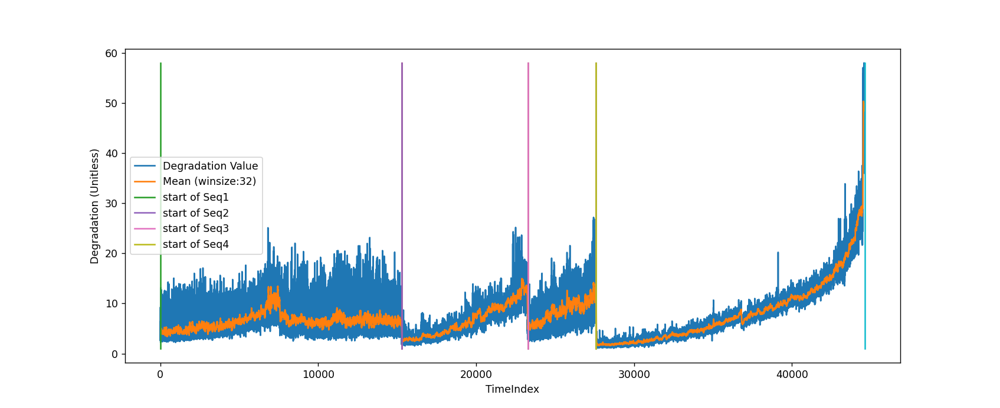

In [40]:
%matplotlib notebook
plt.plot(all_seq_y_tilde_vect, label='Degradation Value')
plt.plot(pd.Series(all_seq_y_tilde_vect).rolling(32).mean(), label='Mean (winsize:32)')

min_y = all_seq_y_tilde_vect.min()
max_y = all_seq_y_tilde_vect.max()


seq_period_iloc = [
    [    0,  15279],
    [ 15279,  23274],
    [ 23274, 27596],
    [27596,  44609]
]

seq_index = 1
for stime_iloc, etime_iloc in seq_period_iloc:
    plt.plot([stime_iloc, stime_iloc], [min_y, max_y], label = "start of Seq{}".format(seq_index))
    plt.plot([etime_iloc, etime_iloc], [min_y, max_y])
    seq_index += 1


plt.ylabel("Degradation (Unitless)")
plt.xlabel("TimeIndex")

plt.legend()
#plt.figure(figsize = (20,20))
plt.show()

In [41]:
import plotly.graph_objects as go

fig = go.Figure()

plot_raw_pts = True
    
fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=all_seq_y_tilde_vect,
        mode='lines',
        name = 'Degradation Metric',
        #mode='lines+markers',
    )
)

fig.add_trace(
    go.Scatter(
        x=np.arange(all_seq_y_tilde_vect.size),
        y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
        mode='lines',
        name = 'Mean(Windowsize:32)',
        #mode='lines+markers',
    )
)

In [42]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
# Create traces
trace0 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=all_seq_y_tilde_vect,
            mode='lines',
            name = 'Degradation Metric',
            #mode='lines+markers',
            )

trace1 = go.Scatter(
            x=np.arange(all_seq_y_tilde_vect.size),
            y=pd.Series(all_seq_y_tilde_vect).rolling(32).mean(),
            mode='lines',
            name = 'Mean(Windowsize:32)',
            #mode='lines+markers',
            )

# Fill out data with our traces
data = [trace0, trace1]
# Plot it and save as basic-line.html
pyo.iplot(data, filename = 'basic-line')

## To see the intmediate feature

In [ ]:
feature_output1 = model.feature_extractor.featuremap1.transpose(1,0).cpu()
feature_output2 = model.feature_extractor.featuremap2.transpose(1,0).cpu()
feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
#feature_output4 = model.model.featuremap4.transpose(1,0).cpu()
#feature_output_fc = model.model.featuremapfc.transpose(1,0).cpu()
feature_output3.shape

In [43]:
def feature_imshow(inp, title=None):
    
    """Imshow for Tensor."""
    
    inp = inp.detach().numpy().transpose((2, 1, 0))
    
    mean = np.array([0.5, 0.5, 0.5])
    
    std = np.array([0.5, 0.5, 0.5])
    
    inp = std * inp + mean
    
    inp = np.clip(inp, 0, 1)
    plt.figure(figsize=(5,5))
    plt.imshow(inp)
    
    if title is not None:
        plt.title(title)
    
    plt.pause(0.001)  # pause a bit so that plots are updated

In [1]:
dl = test_dataloaders[4]
refs = refs_list[4]

curr_refs = refs.float().to(device)
num_data = len(dl)
print(num_data)
    
loss_vect = np.zeros(num_data)
var_res_vect= np.zeros(num_data)

y_vect = np.zeros(num_data)
y_tilde_vect = np.zeros(num_data)

dl_iter = iter(dl)

for i in tqdm(range(5122)):
    try:
        img,label = next(dl_iter)

    except (StopIteration, TypeError):
        dl_iter = iter(curr_train_dl)
        img,label = next(dl_iter)

    y_vect[i] = label

    img = img.float().to(device)
    
    #feature_output3 = model.feature_extractor.featuremapfc.transpose(1,0).cpu()
    
    latent_vector = model.featuremap(img)
    refs_latent_vectors = model.featuremap_refs(curr_refs)
    
    output1 = latent_vector.transpose(1,0).cpu()
    output_refs = refs_latent_vectors.transpose(1,0).cpu()

NameError: name 'test_dataloaders' is not defined

In [ ]:
out = torchvision.utils.make_grid(output1)
feature_imshow(out)

In [ ]:
out = torchvision.utils.make_grid(output_refs)
feature_imshow(out)

# Load the model